input labraries

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation, rc
from IPython.display import HTML

define polt frames and axises

Text(0.5, 0, '$\\beta$')

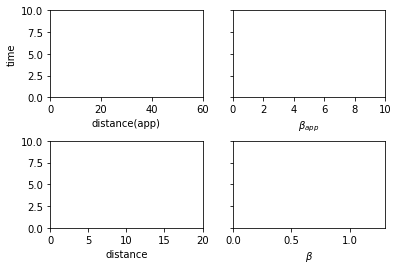

In [2]:
fig, ((ax11, ax12), (ax21, ax22)) = plt.subplots(2,2,
                                 sharex=False,
                                 sharey=True,
                                  tight_layout=False)
fig.subplots_adjust(hspace=0.5)

ax11.set_xlim((0,60))
ax11.set_ylim((0,10))
ax11.set_xlabel('distance(app)')
ax11.set_ylabel('time')

ax12.set_xlim((0,10))
ax12.set_xlabel(r'$\beta_{app}$')

ax21.set_xlim((0,20))
ax21.set_xlabel('distance')

ax22.set_xlim((0,1.3))
ax22.set_xlabel(r'$\beta$')

define varables, range and relations

In [3]:
t=np.linspace(0,10,1000)
gamma=1
beta_t=(1-gamma**(-2))**0.5
beta_app_t=gamma*beta_t
line11, = ax11.plot(beta_app_t*t,t,lw=2)

tt=t*0+1
beta_app=beta_app_t+t*0
line12, = ax12.plot(beta_app,t,lw=2)

beta=beta_t+t*0
line21, = ax21.plot(beta*t,t,lw=2)

line22, =ax22.plot(beta,t,lw=2)

make legends for every subplots

In [4]:
ax11.plot(t,t, label='lightcone edge 1', color='red', linestyle='--')
ax12.plot(tt,t, label='speed of light 1', color='pink', linestyle='--')
ax21.plot(t,t, label='light cone edge 2', color='green', linestyle='--')
ax22.plot(tt,t, label='speed of light 2', color='purple', linestyle='--')

ax11.legend(loc='lower right')
ax12.legend(loc='upper right')
ax21.legend(loc='lower right')
ax22.legend(loc='upper left')

define initialization functions for every curves

In [5]:
def init():
    line11.set_xdata(0)
    line12.set_xdata(0)
    line21.set_xdata(0)
    line22.set_xdata(0)
    return (line11, line12, line21, line22,)

define animation functions for every curves

In [6]:
def animate(i):
    gamma=1+0.01*i
    beta_t=(1-gamma**(-2))**0.5
    beta_app_t=gamma*beta_t
    beta_app=beta_app_t+t*0
    beta=beta_t+t*0
    
    line11.set_xdata(beta_app*t)
    line12.set_xdata(beta_app)
    line21.set_xdata(beta*t)
    line22.set_xdata(beta)
    
    ax11.set_title(r'$\beta_{app}$='+str(beta_app_t))
    ax12.set_title(r'$\beta_{app}$ vs time')
    ax22.set_title(r'$\beta$ vs time')
    ax21.set_title(r'$\beta$='+str(beta_t))
    
    return(line11, line12, line21, line22,)

Compile the animation. Setting blit=False will re-draw all the parts that have changed

In [7]:
anim=animation.FuncAnimation(fig=fig, func=animate, init_func=init,
                             frames=500, interval=20,
                             blit=False)

Now to create an interactive JavaScript widget using the to_jshtml method

In [9]:
HTML(anim.to_jshtml())